In [1]:
import os

os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"  # Arrange GPU devices starting from 0
os.environ["CUDA_VISIBLE_DEVICES"]= "1"  # Set the GPU 1 to use

In [2]:
import torch
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

print('Device:', device)
print('Current cuda device:', torch.cuda.current_device())
print('Count of using GPUs:', torch.cuda.device_count())

Device: cuda
Current cuda device: 0
Count of using GPUs: 1


In [3]:
import huggingface_hub
huggingface_hub.login()


In [3]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer, BitsAndBytesConfig, Trainer, TrainingArguments, DataCollatorForLanguageModeling
from peft import LoraConfig, get_peft_model

# 모델 및 토크나이저 설정
model_name = 'Qwen/Qwen2-7B-Instruct'
quantization_config = BitsAndBytesConfig(
 
    load_in_4bit=True,
    bnb_4bit_compute_dtype=torch.bfloat16  # 연산 정확도를 위한 bfloat16 사용
)

# 모델 로드
model = AutoModelForCausalLM.from_pretrained(
    
    model_name,
    low_cpu_mem_usage=True,
    trust_remote_code=True,
    quantization_config=quantization_config,
)

# LoRA 설정
tokenizer = AutoTokenizer.from_pretrained("Qwen/Qwen2-7B-Instruct")

Loading checkpoint shards:   0%|          | 0/4 [00:00<?, ?it/s]

In [4]:
total_params = sum(p.numel() for p in model.parameters())
trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f"Total parameters: {total_params}")
print(f"Trainable parameters: {trainable_params}")

Total parameters: 4352972288
Trainable parameters: 1090199040


In [4]:
lora_config = LoraConfig(
    r=8,  # 랭크 값 (조정 가능)
    lora_alpha=4,  # 학습 속도에 영향을 미치는 파라미터
    target_modules=["q_proj", "v_proj",'o_proj','lm_head','up_proj','down_proj','gate_proj'],  # LoRA 적용 대상 모듈
    lora_dropout=0.1,  # 드롭아웃 비율
    bias="none" ,
     # LoRA에서 사용할 바이어스 설정
)
# target_modules=["q_proj", "v_proj",'o_proj','lm_head','up_proj','down_proj','gate_proj']
#target_modules=["query_key_value", "dense", "dense_h_to_4h", "dense_4h_to_h"]
# 모델에 QLoRA 적용
model = get_peft_model(model, lora_config)

# 토크나이저 로드


In [5]:
import pandas as pd
from datasets import Dataset,concatenate_datasets
from datasets import load_dataset
prompt_format = """Below is an instruction that describes a task, paired with an input that provides further context. Write a response that appropriately completes the request.

### Instruction:
{}

### Response:
{}"""

EOS_TOKEN = tokenizer.eos_token
def formatting_prompts_func(examples):
    instructions = examples["prompt"]
    outputs = examples["response"]
    texts = []
    for instruction, output in zip(instructions, outputs):
        text = prompt_format.format(instruction, output) + EOS_TOKEN # 마지막에 eos token을 추가해줌으로써 모델이 출력을 끝마칠 수 있게 만들어 줍니다.
        texts.append(text)
    return { "formatted_text" : texts, }
pass



from datasets import load_from_disk

# 로컬 경로에서 데이터셋 불러오기
dataset = load_from_disk("c:/Users/son/Desktop/KRX_compatition/max_length/Lora1_math_v1")

# 데이터셋 확인


combined_dataset = dataset.map(formatting_prompts_func, batched = True)

Map:   0%|          | 0/20424 [00:00<?, ? examples/s]

In [6]:
combined_dataset

Dataset({
    features: ['prompt', 'response', '__index_level_0__', 'formatted_text', 'token_count'],
    num_rows: 20424
})

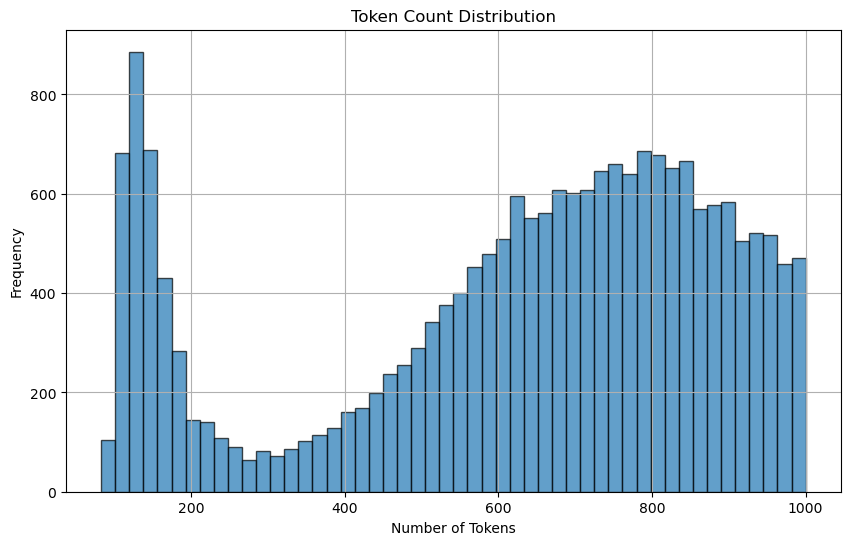

Average Token Count: 621.24089306698
Standard Deviation: 265.1066701412358


In [7]:
import matplotlib.pyplot as plt

# 예시 데이터셋
formatted_texts = combined_dataset["formatted_text"]

# 각 텍스트에 대해 토큰화하고, 토큰의 수를 계산
token_counts = [len(tokenizer(text)["input_ids"]) for text in formatted_texts]

# 토큰 수 분포 확인 (히스토그램으로 시각화)
plt.figure(figsize=(10, 6))
plt.hist(token_counts, bins=50, edgecolor="k", alpha=0.7)
plt.title("Token Count Distribution")
plt.xlabel("Number of Tokens")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()

# 토큰 수의 평균과 표준편차 확인
import numpy as np
print("Average Token Count:", np.mean(token_counts))
print("Standard Deviation:", np.std(token_counts))


In [12]:
formatted_texts[:10]

['Below is an instruction that describes a task, paired with an input that provides further context. Write a response that appropriately completes the request.\n\n### Instruction:\n음악산업의 디지털화가 진행됨에 따라, 전통적인 음반 중심의 수익 모델에서 디지털 음악 서비스 중심으로 변화했음을 설명하는데, 이러한 변화가 이루어진 주된 원인은 무엇이며, 이에 따라 업계가 어떻게 대응하고 있는지 구체적인 예를 들어 설명하시오.\n\n### Response:\n음악산업의 디지털화 주된 원인은 인터넷과 мобиль 서비스의 발달로 인해 소비자들이 음악을 접근하고 소비하는 방식이 변화했기 때문입니다. 디지털 플랫폼의 등장으로 음원 스트리밍 서비스(예: 멜론, 스포티파이 등)가 보편화되면서, 소비자들은 과거의 음반 구매 대신 구독 기반의 서비스를 통해 음악에 쉽게 접근하게 되었습니다.\n\n이에 따라 음악업계는 다양한 대응 전략을 마련하고 있습니다. 예를 들어, 아티스트들은 음원 스트리밍 수익을 최적화하기 위해 SNS와 유튜브를 활용한 마케팅을 강화하고 있으며, 라이브 공연 및 팬미팅과 같은 오프라인 이벤트를 확대하여 추가 수익을 창출하고 있습니다. 또한, 일부 음악 레이블은 아티스트와의 협업을 통해 독점 콘텐츠를 제작하고, 메타버스와 같은 새로운 플랫폼을 이용해 가상 공연을 개최하는 등의 혁신적인 접근법을 시도하고 있습니다.<|im_end|>',
 'Below is an instruction that describes a task, paired with an input that provides further context. Write a response that appropriately completes the request.\n\n### Instruction:\n사후면세점 시장이 최근 몇 년간 급격히 성장한 원인으로는 무엇이 있

In [ ]:
from datasets import Dataset

# 토큰 수를 기준으로 필터링할 최대 토큰 수 설정
max_token_count = 1000  # 필요에 따라 수정

# 각 텍스트에 대해 토큰화하고, 토큰의 수를 계산
def calculate_token_count(example):
    example["token_count"] = len(tokenizer(example["formatted_text"])["input_ids"])
    return example

# 토큰 수 계산을 데이터셋에 적용
combined_dataset = combined_dataset.map(calculate_token_count)

# 토큰 수가 max_token_count 이하인 데이터만 필터링
filtered_dataset = combined_dataset.filter(lambda example: example["token_count"] <= max_token_count)

# 결과 출력
print(f"Original dataset size: {len(combined_dataset)}")
print(f"Filtered dataset size: {len(filtered_dataset)}")
print(f"Removed {len(combined_dataset) - len(filtered_dataset)} entries exceeding {max_token_count} tokens.")

# 필요한 경우 새로운 CSV 파일로 저장



Map:   0%|          | 0/120782 [00:00<?, ? examples/s]

Filter:   0%|          | 0/120782 [00:00<?, ? examples/s]

Original dataset size: 120782
Filtered dataset size: 101902
Removed 18880 entries exceeding 700 tokens.


In [15]:
filtered_dataset

Dataset({
    features: ['prompt', 'response', '__index_level_0__', 'formatted_text', 'token_count'],
    num_rows: 88990
})

In [8]:
# if tokenizer.pad_token is None:
#      tokenizer.add_special_tokens({'pad_token': '[PAD]'})
def tokenize_function(examples):
    return tokenizer(examples["formatted_text"], padding="max_length", truncation=True, max_length=1000)

tokenized_dataset = combined_dataset.map(tokenize_function, batched=True)

# 데이터 콜레이터 설정
data_collator = DataCollatorForLanguageModeling(tokenizer=tokenizer, mlm=False)

Map:   0%|          | 0/20424 [00:00<?, ? examples/s]

## 데이터 처리

In [18]:
from tqdm import tqdm
from sentence_transformers import SentenceTransformer

# SentenceTransformer 모델 로드
model_em = SentenceTransformer("BAAI/bge-m3")

# tokenized_dataset에서 formatted_text를 다시 복원하기
# tokenized_dataset은 토큰화된 상태이므로, 원래 텍스트를 사용해야 임베딩 생성 가능
formatted_texts = [example["formatted_text"] for example in tokenized_dataset]

# tqdm을 사용하여 임베딩 추출


# 결과 확인



In [19]:
embeddings = []
for text in tqdm(formatted_texts, desc="Encoding Sentences"):
    embedding = model_em.encode(text)
    embeddings.append(embedding)

# 결과를 tokenized_dataset에 추가
# tokenized_dataset은 map을 지원하므로 쉽게 결합 가능


Encoding Sentences: 100%|██████████| 117730/117730 [31:59<00:00, 61.32it/s]


In [20]:
embedding

array([-0.03186603,  0.01109321, -0.02973192, ...,  0.00627414,
        0.03650222,  0.0099903 ], dtype=float32)

In [21]:
import numpy as np
import umap.umap_ as umap
import plotly.express as px

# 샘플 임베딩 데이터 생성
embeddings_array =  np.array(embeddings)
# UMAP으로 3D 차원 축소
umap_model = umap.UMAP(n_components=3, random_state=42)
umap_result = umap_model.fit_transform(embeddings_array)

# UMAP 결과를 Plotly로 시각화
fig = px.scatter_3d(
    x=umap_result[:, 0],
    y=umap_result[:, 1],
    z=umap_result[:, 2],
    title="UMAP 3D Visualization",
    labels={"x": "UMAP1", "y": "UMAP2", "z": "UMAP3"},
    opacity=0.7,
    color=np.arange(len(umap_result))  # 데이터 포인트에 따라 색상 지정 (예시)
)

# 그래프 출력
fig.update_traces(marker=dict(size=5))
fig.show()


c:\Users\son\anaconda3\Lib\site-packages\umap\umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



In [22]:
import numpy as np
import umap.umap_ as umap
import plotly.express as px
from sklearn.ensemble import IsolationForest

# 샘플 임베딩 데이터 생성


# 1. Isolation Forest로 이상치 탐지
clf = IsolationForest(contamination=0.1, random_state=42)  # contamination=이상치 비율
labels = clf.fit_predict(embeddings_array)  # 정상 데이터: 1, 이상치: -1

# 이상치와 정상 데이터 색인
outlier_indices = np.where(labels == -1)[0]
normal_indices = np.where(labels == 1)[0]

# 2. UMAP으로 3D 차원 축소
umap_model = umap.UMAP(n_components=3, random_state=42)
umap_result = umap_model.fit_transform(embeddings_array)

# 3. Plotly로 시각화 (이상치와 정상 데이터를 다른 색으로 표시)
# 정상 데이터만 따로 추출
umap_normal = umap_result[normal_indices]
umap_outlier = umap_result[outlier_indices]

# Plotly로 시각화
fig = px.scatter_3d(
    title="UMAP 3D Visualization with Outliers",
    labels={"x": "UMAP1", "y": "UMAP2", "z": "UMAP3"}
)

# 정상 데이터 추가
fig.add_scatter3d(
    x=umap_normal[:, 0],
    y=umap_normal[:, 1],
    z=umap_normal[:, 2],
    mode='markers',
    marker=dict(size=5, color='blue'),
    name='Normal Data'
)

# 이상치 데이터 추가
fig.add_scatter3d(
    x=umap_outlier[:, 0],
    y=umap_outlier[:, 1],
    z=umap_outlier[:, 2],
    mode='markers',
    marker=dict(size=5, color='red'),
    name='Outliers'
)

# 그래프 출력
fig.show()


c:\Users\son\anaconda3\Lib\site-packages\umap\umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



In [21]:
clf = IsolationForest(contamination=0.1, random_state=42)
labels = clf.fit_predict(embeddings)  # 정상 데이터: 1, 이상치: -1

# 2. 이상치 제거
normal_indices = np.where(labels == 1)[0]  # 정상 데이터 인덱스
filtered_dataset = tokenized_dataset.select(normal_indices.tolist()) 

In [22]:
filtered_dataset

Dataset({
    features: ['prompt', 'response', '__index_level_0__', 'formatted_text', 'input_ids', 'attention_mask'],
    num_rows: 44480
})

In [67]:
tokenized_dataset_new = filtered_dataset.map(tokenize_function, batched=True)

# 4. 데이터 콜레이터 설정
data_collator = DataCollatorForLanguageModeling(tokenizer=tokenizer, mlm=False)

Map:   0%|          | 0/91426 [00:00<?, ? examples/s]

In [7]:
tokenized_dataset

Dataset({
    features: ['prompt', 'response', '__index_level_0__', 'formatted_text', 'input_ids', 'attention_mask'],
    num_rows: 49423
})

## 모델 실행

In [9]:


# 학습 인자 설정
training_args = TrainingArguments(
    output_dir="./qwen2-7b-qlora_4",
    per_device_train_batch_size=2,
    gradient_accumulation_steps=3,
    learning_rate=5e-5,
    num_train_epochs=7,
    logging_steps=5,
    fp16=True,
    push_to_hub=False,
    save_steps= -1,

)

# Trainer 생성
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=tokenized_dataset,
    tokenizer=tokenizer,
    data_collator=data_collator
)

# 학습 시작
trainer.train()

  0%|          | 0/23828 [00:00<?, ?it/s]

c:\Users\son\anaconda3\Lib\site-packages\transformers\models\qwen2\modeling_qwen2.py:623: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:555.)
  attn_output = torch.nn.functional.scaled_dot_product_attention(


{'loss': 1.6178, 'grad_norm': 0.19651131331920624, 'learning_rate': 4.998950814168206e-05, 'epoch': 0.0}
{'loss': 1.5505, 'grad_norm': 0.28340885043144226, 'learning_rate': 4.997901628336411e-05, 'epoch': 0.0}
{'loss': 1.4423, 'grad_norm': 0.1756264567375183, 'learning_rate': 4.996852442504617e-05, 'epoch': 0.0}
{'loss': 1.3863, 'grad_norm': 0.23694972693920135, 'learning_rate': 4.9958032566728216e-05, 'epoch': 0.01}
{'loss': 1.3677, 'grad_norm': 0.22429417073726654, 'learning_rate': 4.994754070841028e-05, 'epoch': 0.01}
{'loss': 1.4752, 'grad_norm': 0.22882184386253357, 'learning_rate': 4.993704885009233e-05, 'epoch': 0.01}
{'loss': 1.4598, 'grad_norm': 0.28737932443618774, 'learning_rate': 4.992655699177439e-05, 'epoch': 0.01}
{'loss': 1.3647, 'grad_norm': 0.23252242803573608, 'learning_rate': 4.991606513345644e-05, 'epoch': 0.01}
{'loss': 1.3293, 'grad_norm': 0.2677285075187683, 'learning_rate': 4.99055732751385e-05, 'epoch': 0.01}
{'loss': 1.2577, 'grad_norm': 0.2391662746667862, '

c:\Users\son\anaconda3\Lib\site-packages\peft\utils\save_and_load.py:227: UserWarning: Setting `save_embedding_layers` to `True` as embedding layers found in `target_modules`.
  warnings.warn("Setting `save_embedding_layers` to `True` as embedding layers found in `target_modules`.")


{'train_runtime': 286236.1869, 'train_samples_per_second': 0.499, 'train_steps_per_second': 0.083, 'train_loss': 0.9721315039951208, 'epoch': 7.0}


TrainOutput(global_step=23828, training_loss=0.9721315039951208, metrics={'train_runtime': 286236.1869, 'train_samples_per_second': 0.499, 'train_steps_per_second': 0.083, 'total_flos': 6.082829676306432e+18, 'train_loss': 0.9721315039951208, 'epoch': 7.0})

In [21]:
trainer.save_model("lora_model/Qwen2-7B-Instruct_extension_finreport_data_new6_5")

In [ ]:
trainer.save_model("")

In [25]:
model_2 = trainer.model.base_model

In [19]:
model_1 = model.merge_and_unload()
model_1._hf_peft_config_loaded = False
model_1.save_pretrained("Qwen2-7B-Instruct_extension_finreport_data_new6_5")
tokenizer.save_pretrained("Qwen2-7B-Instruct_extension_finreport_data_new6_5")

# Merged model 저장 및 업로드


c:\Users\son\anaconda3\Lib\site-packages\peft\tuners\lora\bnb.py:336: UserWarning: Merge lora module to 4-bit linear may get different generations due to rounding errors.
  warnings.warn(


('Qwen2-7B-Instruct_extension_finreport_data_new6_5\\tokenizer_config.json',
 'Qwen2-7B-Instruct_extension_finreport_data_new6_5\\special_tokens_map.json',
 'Qwen2-7B-Instruct_extension_finreport_data_new6_5\\vocab.json',
 'Qwen2-7B-Instruct_extension_finreport_data_new6_5\\merges.txt',
 'Qwen2-7B-Instruct_extension_finreport_data_new6_5\\added_tokens.json',
 'Qwen2-7B-Instruct_extension_finreport_data_new6_5\\tokenizer.json')